In [1]:
#Import all necessities
import pandas as pd
import numpy as np
from bs4 import BeautifulSoup
import json
import requests
import folium
from geopy.geocoders import Nominatim
from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe

from sklearn.cluster import KMeans
from yellowbrick.cluster import KElbowVisualizer
import seaborn as sns
# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors
import matplotlib.pyplot as plt

from OSGridConverter import grid2latlong

In [2]:
df = pd.read_html('https://en.wikipedia.org/wiki/List_of_areas_of_London')
df = df[1] # select right table
df = df.dropna().reset_index(drop=True) 


In [3]:
#Convert OS grid ref to Lat, Long
Lat = []
Long = []
for i in range(len(df)):
    l = grid2latlong(df['OS grid ref'][i])
    Lat.append(l.latitude)
    Long.append(l.longitude)
    
df['Latitude']=Lat
df['Longitude']=Long


In [4]:
#Rename Neighborhood column
df.columns=['Neighborhood', 'Borough', 'Post town', 'Postcode district',
       'Dial code', 'OS grid ref', 'Latitude', 'Longitude']

In [5]:
df=df[['Neighborhood','Borough','Latitude','Longitude']]

In [6]:
len(df['Borough'].unique())

127

In [7]:
df['Borough']=df['Borough'].str.replace(r"\[.*\]","") #replace citation brackets from wikipediadata

In [8]:
len(df['Borough'].unique())

60

In [9]:
#Consider boundary neighborhoods
#if neighbourhood lays in multiple boroughs remove last
# As the goal is to include demographics data, maybe for these  boundaryneighbourhoods it would be better to take the
#mean value instead focusing on one 
df['Borough']= df['Borough'].str.replace(r',[^,]*$', '')
df['Borough']= df['Borough'].str.replace(r',[^,]*$', '')
df['Borough'].str.replace(r',[^,]*$', '').unique()

array(['Bexley', 'Ealing', 'Croydon', 'Redbridge', 'City', 'Westminster',
       'Brent', 'Bromley', 'Islington', 'Havering', 'Barnet', 'Enfield',
       'Wandsworth', 'Southwark', 'Barking and Dagenham',
       'Richmond upon Thames', 'Newham', 'Sutton', 'Lewisham', 'Harrow',
       'Camden', 'Kingston upon Thames', 'Tower Hamlets', 'Greenwich',
       'Haringey', 'Hounslow', 'Lambeth', 'Kensington and Chelsea',
       'Waltham Forest', 'Merton', 'Hillingdon', 'Hackney',
       'Hammersmith and Fulham'], dtype=object)

## Insert the demographics .csv from Kaggle (https://www.kaggle.com/marshald/london-boroughs9 , select some data and join the dataframes


In [10]:
demo_df=pd.read_csv('london-borough-profiles-2016Dataset.csv')
demo_df=demo_df.drop([0,34,35,36,37,38,39]) # Only want the rows with the boroughs
demo_df.loc[1,'Area name']='City' # City and City of London is equal


In [11]:
demo_df.columns

Index(['Code', 'New code', 'Area name', 'Inner/ Outer London',
       'GLA Population Estimate 2016', 'GLA Household Estimate 2016',
       'Inland Area (Hectares)', 'Population density (per hectare) 2016',
       'Average Age, 2016', 'Proportion of population aged 0-15, 2016',
       'Proportion of population of working-age, 2016',
       'Proportion of population aged 65 and over, 2016',
       'Net internal migration (2014)', 'Net international migration (2014)',
       'Net natural change (2014)',
       '% of resident population born abroad (2014)',
       'Largest migrant population by country of birth (2011)',
       '% of largest migrant population (2011)',
       'Second largest migrant population by country of birth (2011)',
       '% of second largest migrant population (2011)',
       'Third largest migrant population by country of birth (2011)',
       '% of third largest migrant population (2011)',
       '% of population from BAME groups (2016)',
       '% people aged 3+

In [12]:
demo_df['Childhood Obesity Prevalance (%) 2014/15'].fillna(demo_df['Childhood Obesity Prevalance (%) 2014/15'].astype('float64').mean())
#replace nan with mean

1     22.275
2       25.3
3       18.4
4       21.4
5       23.9
6       16.5
7       20.8
8       23.8
9       23.3
10      25.4
11      24.5
12      25.6
13      23.3
14      22.6
15      21.1
16      20.8
17      19.8
18      22.8
19      22.8
20      21.5
21      15.8
22      27.1
23      24.2
24      21.6
25      27.4
26      22.9
27      11.2
28      28.0
29      17.4
30      26.7
31      21.7
32      20.7
33      24.5
Name: Childhood Obesity Prevalance (%) 2014/15, dtype: object

In [13]:
df['Borough'].unique()

array(['Bexley', 'Ealing', 'Croydon', 'Redbridge', 'City', 'Westminster',
       'Brent', 'Bromley', 'Islington', 'Havering', 'Barnet', 'Enfield',
       'Wandsworth', 'Southwark', 'Barking and Dagenham',
       'Richmond upon Thames', 'Newham', 'Sutton', 'Lewisham', 'Harrow',
       'Camden', 'Kingston upon Thames', 'Tower Hamlets', 'Greenwich',
       'Haringey', 'Hounslow', 'Lambeth', 'Kensington and Chelsea',
       'Waltham Forest', 'Merton', 'Hillingdon', 'Hackney',
       'Hammersmith and Fulham'], dtype=object)

In [14]:
df

,Neighborhood,Borough,Latitude,Longitude
0,Abbey Wood,Bexley,51.486484,0.109318
1,Acton,Ealing,51.510591,-0.264585
2,Addington,Croydon,51.362934,-0.025780
3,Addiscombe,Croydon,51.381625,-0.068126
4,Albany Park,Bexley,51.434929,0.125663
...,...,...,...,...
524,Woolwich,Greenwich,51.496238,0.066504
525,Worcester Park,Sutton,51.375352,-0.240950
526,Wormwood Scrubs,Hammersmith and Fulham,51.519148,-0.235411
527,Yeading,Hillingdon,51.530413,-0.393669


In [15]:
#Add demographics to Neighborhoodsdataframe

'Average Age, 2016'
'Employment rate (%) (2015)'
'Proportion of population aged 0-15, 2016'
'Proportion of population of working-age, 2016'
'Proportion of population aged 65 and over, 2016'
'Modelled Household median income estimates 2012/13'
'Two-year business survival rates (started in 2012)'
'Number of cars, (2011 Census)'
'Number of cars per household, (2011 Census)'
'Life satisfaction score 2011-14 (out of 10)'
'Worthwhileness score 2011-14 (out of 10)'
'Happiness score 2011-14 (out of 10)'
'Anxiety score 2011-14 (out of 10)'
'Childhood Obesity Prevalance (%) 2014/15'
'People aged 17+ with diabetes (%)'


AvgAge=[]
EmplRate=[]
PropYoung=[]
PropMiddle=[]
PropOld=[]
HouseMeadian=[]
BusSurv=[]
NoCars=[]
NoCarsHous=[]
LifSat=[]
Worthwile=[]
Happines=[]
Anxiety=[]
ChildObes=[]
Diabetes=[]
for i in range(len(df.Neighborhood)):
    AvgAge.append(demo_df[demo_df['Area name'] == df.Borough[i]]['Average Age, 2016'].item())
    EmplRate.append(demo_df[demo_df['Area name'] == df.Borough[i]]['Employment rate (%) (2015)'].item())
    PropYoung.append(demo_df[demo_df['Area name'] == df.Borough[i]]['Proportion of population aged 0-15, 2016'].item())
    PropMiddle.append(demo_df[demo_df['Area name'] == df.Borough[i]]['Proportion of population of working-age, 2016'].item())
    PropOld.append(demo_df[demo_df['Area name'] == df.Borough[i]]['Proportion of population aged 65 and over, 2016'].item())
    HouseMeadian.append(demo_df[demo_df['Area name'] == df.Borough[i]]['Modelled Household median income estimates 2012/13'].item())
    BusSurv.append(demo_df[demo_df['Area name'] == df.Borough[i]]['Two-year business survival rates (started in 2012)'].item())
    NoCars.append(demo_df[demo_df['Area name'] == df.Borough[i]]['Number of cars, (2011 Census)'].item())
    NoCarsHous.append(demo_df[demo_df['Area name'] == df.Borough[i]]['Number of cars per household, (2011 Census)'].item())
    LifSat.append(demo_df[demo_df['Area name'] == df.Borough[i]]['Life satisfaction score 2011-14 (out of 10)'].item())
    Worthwile.append(demo_df[demo_df['Area name'] == df.Borough[i]]['Worthwhileness score 2011-14 (out of 10)'].item())
    Happines.append(demo_df[demo_df['Area name'] == df.Borough[i]]['Happiness score 2011-14 (out of 10)'].item())
    Anxiety.append(demo_df[demo_df['Area name'] == df.Borough[i]]['Anxiety score 2011-14 (out of 10)'].item())
    ChildObes.append(demo_df[demo_df['Area name'] == df.Borough[i]]['Childhood Obesity Prevalance (%) 2014/15'].item())
    Diabetes.append(demo_df[demo_df['Area name'] == df.Borough[i]]['People aged 17+ with diabetes (%)'].item())


df['Average_Age']=AvgAge
df['Employment_Rate']= EmplRate
df['Population0-15']= PropYoung
df['Population0-65']= PropMiddle
df['Population65+']= PropOld
df['Estimate_Household_Median']= HouseMeadian
df['Business_Suvrival_Rate_Two_Years']= BusSurv
df['Number_Cars']= NoCars
df['Number_Cars_per_Houshold']= NoCarsHous
df['LifeSatisfaction']= LifSat
df['Worthwile']= Worthwile
df['Happiness']= Happines
df['Anxiety']= Anxiety
df['ChildObesety']= ChildObes
df['DiabetesPrevalence']= Diabetes

In [16]:
# Replace Literals to convert object to float
df['Estimate_Household_Median']=df['Estimate_Household_Median'].str.replace(u'£', "") 
df['Estimate_Household_Median']=df['Estimate_Household_Median'].str.replace(u',', "")
df['Number_Cars']=df['Number_Cars'].str.replace(u',', "")
df[['ChildObesety','Estimate_Household_Median','Number_Cars']]= df[['ChildObesety','Estimate_Household_Median','Number_Cars']].astype('float64')


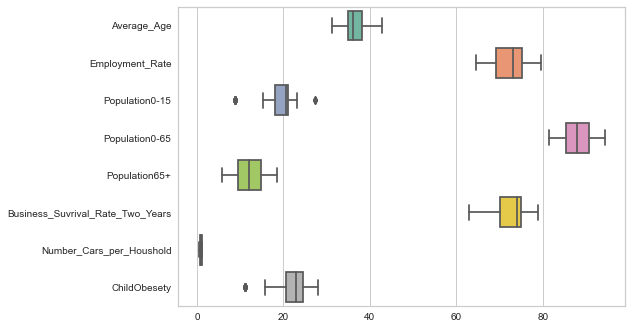

In [17]:
#Outlier analysis/ Understanding the data a little bit
# Group data more or less by range, first plot are mostly percentages or numbers up to 100
#second plot are big numbers 
# third plot are numbers up to ten
ax = sns.boxplot(data=df[['Average_Age',
       'Employment_Rate', 'Population0-15', 'Population0-65', 'Population65+',
      'Business_Suvrival_Rate_Two_Years',
        'Number_Cars_per_Houshold','ChildObesety']], orient="h", palette="Set2")

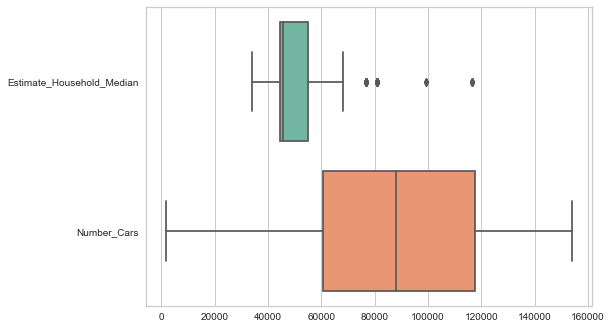

In [18]:
ax = sns.boxplot(data=df[['Estimate_Household_Median',
       'Number_Cars']], orient="h", palette="Set2")

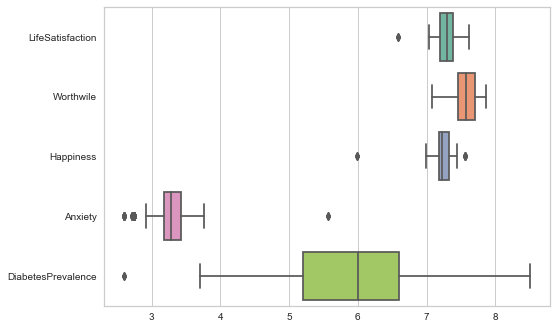

In [19]:
ax = sns.boxplot(data=df[[ 'LifeSatisfaction',
       'Worthwile', 'Happiness', 'Anxiety',
       'DiabetesPrevalence']], orient="h", palette="Set2")

<AxesSubplot:>

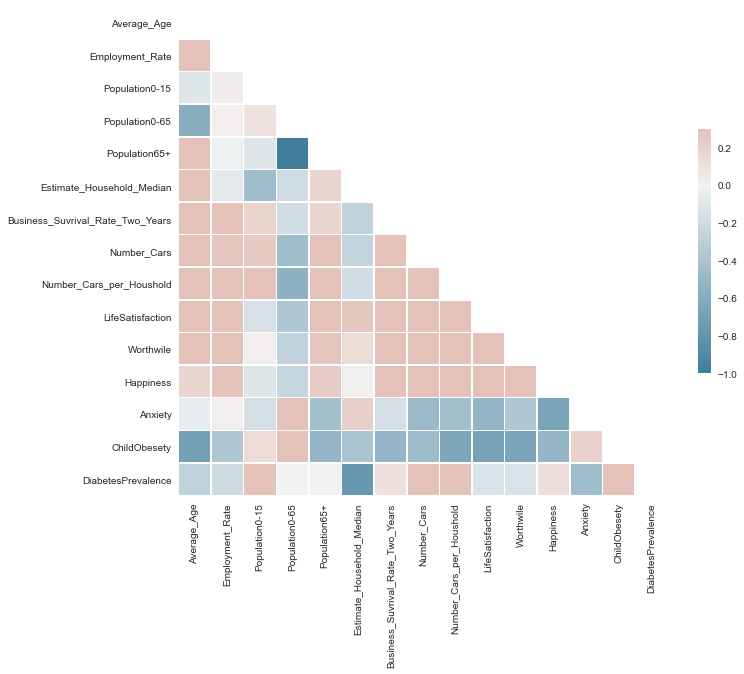

In [20]:
corr = df[['Average_Age',
       'Employment_Rate', 'Population0-15', 'Population0-65', 'Population65+',
       'Estimate_Household_Median', 'Business_Suvrival_Rate_Two_Years',
       'Number_Cars', 'Number_Cars_per_Houshold', 'LifeSatisfaction',
       'Worthwile', 'Happiness', 'Anxiety', 'ChildObesety',
       'DiabetesPrevalence']].corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

#I expected some correlation between estimate_household_median and number_cars_per household but we can see on the maps later 
# why this isnt the reason. Whats interesting, that child obesety is negatively correlated with a lot of different features. 
# But on hindsight this all makes sense.

### Create some demographic maps:

In [21]:
bins = list(df["Estimate_Household_Median"].quantile([0, 0.25, 0.5, 0.75, 1]))
state_geo="london_boroughs.json"
m = folium.Map(location=[51.5,0], zoom_start=9)

folium.Choropleth(
    geo_data=state_geo,
    data=df,
    columns=["Borough","Estimate_Household_Median"],
    key_on="feature.properties.name",
    fill_color="BuPu",
    fill_opacity=0.7,
    line_opacity=0.5,
    legend_name="Estimate Household Median",
    bins=bins,
    reset=True,
).add_to(m)

m



In [22]:
# I expected to see a correlation between estimate_household_median and number of cars per household, but in hindsight 
# people in the outer districts need more cars than people living in the city centre.
bins = list(df["Number_Cars_per_Houshold"].quantile([0, 0.25, 0.5, 0.75, 1]))
state_geo="london_boroughs.json"
m = folium.Map(location=[51.5,0], zoom_start=9)

folium.Choropleth(
    geo_data=state_geo,
    data=df,
    columns=["Borough","Number_Cars_per_Houshold"],
    key_on="feature.properties.name",
    fill_color="BuPu",
    fill_opacity=0.7,
    line_opacity=0.5,
    legend_name="Number of Cars per Household",
    bins=bins,
    reset=True,
).add_to(m)

m


## Some Maps for the age distribution, but as the demographic data is just for the borouhgs and not for the neighborhoods, the data is a bit coarse.

In [23]:
bins = list(df["Population0-65"].quantile([0, 0.25, 0.5, 0.75, 1]))
state_geo="london_boroughs.json"
m = folium.Map(location=[51.5,0], zoom_start=9)

folium.Choropleth(
    geo_data=state_geo,
    data=df,
    columns=["Borough","Population0-65"],
    key_on="feature.properties.name",
    fill_color="BuPu",
    fill_opacity=0.7,
    line_opacity=0.5,
    legend_name="Population0-65 in %",
    bins=bins,
    reset=True,
).add_to(m)

m

In [24]:
bins = list(df["Population0-15"].quantile([0, 0.25, 0.5, 0.75, 1]))
state_geo="london_boroughs.json"
m = folium.Map(location=[51.5,0], zoom_start=9)

folium.Choropleth(
    geo_data=state_geo,
    data=df,
    columns=["Borough","Population0-15"],
    key_on="feature.properties.name",
    fill_color="BuPu",
    fill_opacity=0.7,
    line_opacity=0.5,
    legend_name="Population0-15 in %",
    bins=bins,
    reset=True,
).add_to(m)

m

In [25]:
bins = list(df["Population65+"].quantile([0, 0.25, 0.5, 0.75, 1]))
state_geo="london_boroughs.json"
m = folium.Map(location=[51.5,0], zoom_start=9)

folium.Choropleth(
    geo_data=state_geo,
    data=df,
    columns=["Borough","Population65+"],
    key_on="feature.properties.name",
    fill_color="BuPu",
    fill_opacity=0.7,
    line_opacity=0.5,
    legend_name="Population0-15 in %",
    bins=bins,
    reset=True,
).add_to(m)

m

In [26]:
bins = list(df["Happiness"].quantile([0, 0.25, 0.5, 0.75, 1]))
state_geo="london_boroughs.json"
m = folium.Map(location=[51.5,0], zoom_start=9)

folium.Choropleth(
    geo_data=state_geo,
    data=df,
    columns=["Borough","Happiness"],
    key_on="feature.properties.name",
    fill_color="BuPu",
    fill_opacity=0.7,
    line_opacity=0.5,
    legend_name="Happiness from 0 to 10",
    bins=bins,
    reset=True,
).add_to(m)

m

## After we have seen some insights of Londons demographics, its now to time fetch some venue data from foursquare api

In [27]:
# create map of neighborhoods in London using latitude and longitude values
map_london = folium.Map(location=[51.5,0], zoom_start=10)

# add markers to map
for lat, lng, borough, neighborhood in zip(df['Latitude'], df['Longitude'], df['Borough'], df['Neighborhood']):
    label = '{}, {}'.format(neighborhood, borough)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_london)  
    
map_london

In [28]:
CLIENT_ID = 'AYHRP1RTXAPCLFKPF2UPSVDQVRTXLFAAS24HS5JNQWLP2DTS' # your Foursquare ID
CLIENT_SECRET = 'F3LCEBTQ1EABQCKVQ21MUZGRHJD1MY1MOHICNE5F3Q4O5PYB' # your Foursquare Secret
VERSION = '20180605' # Foursquare API version
LIMIT = 100 # A default Foursquare API limit value

print('Your credentails:')
print('CLIENT_ID: ' + CLIENT_ID)
print('CLIENT_SECRET:' + CLIENT_SECRET)

Your credentails:
CLIENT_ID: AYHRP1RTXAPCLFKPF2UPSVDQVRTXLFAAS24HS5JNQWLP2DTS
CLIENT_SECRET:F3LCEBTQ1EABQCKVQ21MUZGRHJD1MY1MOHICNE5F3Q4O5PYB


In [29]:
neighborhood_latitude = df.loc[0, 'Latitude'] # neighborhood latitude value
neighborhood_longitude = df.loc[0, 'Longitude'] # neighborhood longitude value

neighborhood_name = df.loc[0, 'Neighborhood'] # neighborhood name

print('Latitude and longitude values of {} are {}, {}.'.format(neighborhood_name, 
                                                               neighborhood_latitude, 
                                                               neighborhood_longitude))

Latitude and longitude values of Abbey Wood are 51.48648353740194, 0.10931788814329141.


In [30]:
LIMIT=1000
radius =3000
# type your answer here
url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
    CLIENT_ID, 
    CLIENT_SECRET, 
    VERSION, 
    neighborhood_latitude, 
    neighborhood_longitude, 
    radius, 
    LIMIT)
url

'https://api.foursquare.com/v2/venues/explore?&client_id=AYHRP1RTXAPCLFKPF2UPSVDQVRTXLFAAS24HS5JNQWLP2DTS&client_secret=F3LCEBTQ1EABQCKVQ21MUZGRHJD1MY1MOHICNE5F3Q4O5PYB&v=20180605&ll=51.48648353740194,0.10931788814329141&radius=3000&limit=1000'

In [31]:
results = requests.get(url).json()
results

{'meta': {'code': 200, 'requestId': '609a48eff953bc7ec7b68a23'},
 'response': {'suggestedFilters': {'header': 'Tap to show:',
   'filters': [{'name': 'Open now', 'key': 'openNow'}]},
  'headerLocation': 'London',
  'headerFullLocation': 'London',
  'headerLocationGranularity': 'city',
  'totalResults': 85,
  'suggestedBounds': {'ne': {'lat': 51.513483564401966,
    'lng': 0.15259659003911497},
   'sw': {'lat': 51.45948351040191, 'lng': 0.06603918624746785}},
  'groups': [{'type': 'Recommended Places',
    'name': 'recommended',
    'items': [{'reasons': {'count': 0,
       'items': [{'summary': 'This spot is popular',
         'type': 'general',
         'reasonName': 'globalInteractionReason'}]},
      'venue': {'id': '557c3971498ec5857dd9bdf4',
       'name': 'The Plumstead Pantry',
       'location': {'address': '16 Warwick Terrace',
        'lat': 51.481712277210015,
        'lng': 0.08370658454028887,
        'labeledLatLngs': [{'label': 'display',
          'lat': 51.481712277210

In [32]:
# function that extracts the category of the venue
def get_category_type(row):
    try:
        categories_list = row['categories']
    except:
        categories_list = row['venue.categories']
        
    if len(categories_list) == 0:
        return None
    else:
        return categories_list[0]['name']

In [33]:
def getNearbyVenues(names, latitudes, longitudes, radius=500):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Neighborhood', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

In [34]:
london_venues = getNearbyVenues(names=df['Neighborhood'],
                                   latitudes=df['Latitude'],
                                   longitudes=df['Longitude']
                                  )

Abbey Wood
Acton
Addington
Addiscombe
Albany Park
Aldborough Hatch
Aldgate
Aldwych
Alperton
Anerley
Angel
Aperfield
Archway
Ardleigh Green
Arkley
Arnos Grove
Balham
Bankside
Barbican
Barking
Barkingside
Barnehurst
Barnes
Barnes Cray
Barnet Gate
Barnet (also Chipping Barnet, High Barnet)
Barnsbury
Battersea
Bayswater
Beckenham
Beckton
Becontree
Becontree Heath
Beddington
Bedford Park
Belgravia
Bellingham
Belmont
Belmont
Belsize Park
Belvedere
Bermondsey
Berrylands
Bethnal Green
Bexley (also Old Bexley, Bexley Village)
Bexleyheath (also Bexley New Town)
Bickley
Biggin Hill
Blackfen
Blackfriars
Blackheath
Blackheath Royal Standard
Blackwall
Bloomsbury
Botany Bay
Bounds Green
Bow
Bowes Park
Brentford
Brent Cross
Brent Park
Brimsdown
Brixton
Brockley
Bromley
Bromley (also Bromley-by-Bow)
Bromley Common
Brompton
Brondesbury
Brunswick Park
Bulls Cross
Burnt Oak
Burroughs, The
Camberwell
Cambridge Heath
Camden Town
Canary Wharf
Cann Hall
Canning Town
Canonbury
Carshalton
Castelnau
Castle Green

In [35]:
london_venues.groupby('Neighborhood').count()

,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
Neighborhood,,,,,,
Abbey Wood,1,1,1,1,1,1
Acton,13,13,13,13,13,13
Addington,2,2,2,2,2,2
Addiscombe,15,15,15,15,15,15
Albany Park,4,4,4,4,4,4
...,...,...,...,...,...,...
Woolwich,21,21,21,21,21,21
Worcester Park,12,12,12,12,12,12
Wormwood Scrubs,8,8,8,8,8,8


In [36]:
print('There are {} uniques categories.'.format(len(london_venues['Venue Category'].unique())))

There are 415 uniques categories.


In [59]:
london_venues.to_pickle("london_venues.pkl")

# Analyze  the neighbourhoods

In [37]:
# one hot encoding
london_onehot = pd.get_dummies(london_venues[['Venue Category']], prefix="", prefix_sep="")

# add neighborhood column back to dataframe
london_onehot['Neighborhood'] = london_venues['Neighborhood'] 

# move neighborhood column to the first column
fixed_columns = [london_onehot.columns[-1]] + list(london_onehot.columns[:-1])
london_onehot = london_onehot[fixed_columns]

london_onehot.head()

,Zoo Exhibit,Acai House,Accessories Store,Adult Boutique,Afghan Restaurant,African Restaurant,Airport,Airport Lounge,Airport Service,American Restaurant,...,Whisky Bar,Windmill,Wine Bar,Wine Shop,Winery,Wings Joint,Women's Store,Xinjiang Restaurant,Yoga Studio,Zoo
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [38]:
london_onehot.shape

(10971, 415)

In [39]:
london_grouped = london_onehot.groupby('Neighborhood').mean().reset_index()
london_grouped.shape

(521, 415)

In [40]:
num_top_venues = 5

for hood in london_grouped['Neighborhood']:
    print("----"+hood+"----")
    temp = london_grouped[london_grouped['Neighborhood'] == hood].T.reset_index()
    temp.columns = ['venue','freq']
    temp = temp.iloc[1:]
    temp['freq'] = temp['freq'].astype(float)
    temp = temp.round({'freq': 2})
    print(temp.sort_values('freq', ascending=False).reset_index(drop=True).head(num_top_venues))
    print('\n')

----Abbey Wood----
           venue  freq
0  Grocery Store   1.0
1    Zoo Exhibit   0.0
2         Office   0.0
3       Pharmacy   0.0
4      Pet Store   0.0


----Acton----
                  venue  freq
0  Gym / Fitness Center  0.15
1                   Pub  0.15
2                Bakery  0.08
3           Supermarket  0.08
4             Mini Golf  0.08


----Addington----
                  venue  freq
0  Gym / Fitness Center   0.5
1                  Park   0.5
2           Zoo Exhibit   0.0
3                Office   0.0
4              Pharmacy   0.0


----Addiscombe----
                  venue  freq
0                  Park  0.20
1         Grocery Store  0.20
2                Bakery  0.13
3  Fast Food Restaurant  0.13
4          Tram Station  0.13


----Albany Park----
                           venue  freq
0                  Train Station  0.25
1                  Grocery Store  0.25
2                            Pub  0.25
3              Indian Restaurant  0.25
4  Paper / Office Supplies St

                venue  freq
0         Coffee Shop  0.21
1         Supermarket  0.14
2                 Pub  0.14
3       Grocery Store  0.14
4  Chinese Restaurant  0.07


----Bexleyheath (also Bexley New Town)----
                  venue  freq
0                   Pub  0.21
1    Mexican Restaurant  0.07
2    Italian Restaurant  0.07
3  Fast Food Restaurant  0.07
4     Indian Restaurant  0.07


----Bickley----
                venue  freq
0       Train Station  0.25
1         Flower Shop  0.25
2      Cricket Ground  0.25
3        Home Service  0.25
4  Photography Studio  0.00


----Biggin Hill----
                        venue  freq
0                 Supermarket  0.25
1               Grocery Store  0.25
2  Construction & Landscaping  0.25
3                        Pool  0.25
4                 Zoo Exhibit  0.00


----Blackfen----
                  venue  freq
0                  Park  0.17
1          Dance Studio  0.17
2  Himalayan Restaurant  0.17
3  Fast Food Restaurant  0.17
4             

           venue  freq
0  Metro Station   1.0
1    Zoo Exhibit   0.0
2         Office   0.0
3       Pharmacy   0.0
4      Pet Store   0.0


----Dalston----
                   venue  freq
0                 Bakery  0.08
1                    Pub  0.05
2          Grocery Store  0.05
3  Vietnamese Restaurant  0.05
4        Thai Restaurant  0.05


----De Beauvoir Town----
           venue  freq
0           Café  0.08
1            Pub  0.08
2       Bus Stop  0.06
3  Deli / Bodega  0.06
4     Restaurant  0.06


----Denmark Hill----
                   venue  freq
0                   Café  0.19
1                    Pub  0.19
2            Coffee Shop  0.12
3                    Bar  0.06
4  Vietnamese Restaurant  0.06


----Deptford----
                   venue  freq
0            Coffee Shop   0.2
1                    Pub   0.2
2            Art Gallery   0.1
3  Vietnamese Restaurant   0.1
4             Restaurant   0.1


----Derry Downs----
           venue  freq
0  Jewelry Store  0.25
1   Home Se

                  venue  freq
0                   Pub  0.23
1   Rental Car Location  0.15
2              Bus Stop  0.15
3                   Spa  0.08
4  Fast Food Restaurant  0.08


----Harmondsworth----
                 venue  freq
0                  Bar  0.18
1  Rental Car Location  0.18
2                 Café  0.09
3            Pet Store  0.09
4      Bed & Breakfast  0.09


----Harold Hill----
          venue  freq
0    Restaurant  0.33
1  Home Service  0.33
2          Park  0.33
3     Piano Bar  0.00
4      Pharmacy  0.00


----Harold Park----
                venue  freq
0  Miscellaneous Shop  0.25
1            Bus Stop  0.25
2   Convenience Store  0.25
3                 Gym  0.25
4         Zoo Exhibit  0.00


----Harold Wood----
               venue  freq
0    Automotive Shop  0.25
1      Grocery Store  0.25
2  Indian Restaurant  0.25
3                Pub  0.25
4        Zoo Exhibit  0.00


----Harringay----
                venue  freq
0  Turkish Restaurant  0.36
1                C

          venue  freq
0      Bus Stop  0.15
1           Pub  0.10
2   Coffee Shop  0.10
3   Pizza Place  0.08
4  Burger Joint  0.05


----Mill Hill----
                venue  freq
0                 Pub  0.25
1                Café  0.25
2  Athletics & Sports  0.25
3                Farm  0.25
4   Outdoor Sculpture  0.00


----Millbank----
               venue  freq
0              Hotel  0.11
1        Coffee Shop  0.09
2   Sushi Restaurant  0.06
3          Juice Bar  0.04
4  Indian Restaurant  0.04


----Millwall----
                       venue  freq
0                        Bar  0.11
1                      Trail  0.11
2  Middle Eastern Restaurant  0.11
3                   Bus Stop  0.11
4           Business Service  0.11


----Mitcham----
                        venue  freq
0                        Lake   0.2
1  Construction & Landscaping   0.2
2   Indian Chinese Restaurant   0.2
3               Memorial Site   0.2
4                        Park   0.2


----Monken Hadley----
         ven

               venue  freq
0           Platform  0.28
1               Café  0.17
2        Coffee Shop  0.11
3               Park  0.06
4  Indian Restaurant  0.06


----Selsdon----
         venue  freq
0  Coffee Shop  0.50
1  Supermarket  0.25
2         Café  0.25
3  Zoo Exhibit  0.00
4         Park  0.00


----Seven Kings----
                        venue  freq
0        Fast Food Restaurant  0.38
1                 Supermarket  0.12
2                   Irish Pub  0.12
3           Convenience Store  0.12
4  Construction & Landscaping  0.12


----Seven Sisters----
                 venue  freq
0          Coffee Shop  0.19
1                  Pub  0.12
2        Grocery Store  0.12
3       Hardware Store  0.06
4  Fried Chicken Joint  0.06


----Shacklewell----
                venue  freq
0        Cocktail Bar  0.11
1  Turkish Restaurant  0.11
2         Yoga Studio  0.08
3    Kebab Restaurant  0.05
4                 Pub  0.05


----Shadwell----
                venue  freq
0  Chinese Restaurant

                  venue  freq
0  Fast Food Restaurant   1.0
1           Zoo Exhibit   0.0
2                  Park   0.0
3              Pharmacy   0.0
4             Pet Store   0.0


----Upper Walthamstow----
                       venue  freq
0         Turkish Restaurant  0.18
1              Garden Center  0.09
2                        Pub  0.09
3              Train Station  0.09
4  Middle Eastern Restaurant  0.09


----Upton----
                  venue  freq
0                   Pub  0.21
1    Mexican Restaurant  0.07
2    Italian Restaurant  0.07
3  Fast Food Restaurant  0.07
4     Indian Restaurant  0.07


----Upton Park----
       venue  freq
0        Pub   0.2
1   Bus Line   0.2
2   Bus Stop   0.2
3   Boutique   0.2
4  Bookstore   0.2


----Uxbridge----
                  venue  freq
0    Chinese Restaurant   0.2
1                  Park   0.2
2  Gym / Fitness Center   0.2
3                   Gym   0.2
4             Bookstore   0.2


----Vauxhall----
         venue  freq
0   Restaura

Create dataframe with this information

In [41]:
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

In [42]:
num_top_venues = 10

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Neighborhood']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
neighborhoods_venues_sorted = pd.DataFrame(columns=columns)
neighborhoods_venues_sorted['Neighborhood'] = london_grouped['Neighborhood']

for ind in np.arange(london_grouped.shape[0]):
    neighborhoods_venues_sorted.iloc[ind, 1:] = return_most_common_venues(london_grouped.iloc[ind, :], num_top_venues)

neighborhoods_venues_sorted.head()

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Abbey Wood,Grocery Store,Zoo,Furniture / Home Store,Fabric Shop,Falafel Restaurant,Farm,Farmers Market,Fast Food Restaurant,Filipino Restaurant,Film Studio
1,Acton,Pub,Gym / Fitness Center,Creperie,Supermarket,Mini Golf,Park,Grocery Store,Bakery,Train Station,Indian Restaurant
2,Addington,Gym / Fitness Center,Park,Zoo,Fruit & Vegetable Store,Fabric Shop,Falafel Restaurant,Farm,Farmers Market,Fast Food Restaurant,Filipino Restaurant
3,Addiscombe,Grocery Store,Park,Tram Station,Bakery,Fast Food Restaurant,Pub,Diner,Café,Fish & Chips Shop,Falafel Restaurant
4,Albany Park,Grocery Store,Indian Restaurant,Pub,Train Station,Zoo,Fish & Chips Shop,Exhibit,Fabric Shop,Falafel Restaurant,Farm


In [43]:
london_venues.shape

(10971, 7)

In [44]:
# Find Foodserving places, we probably miss some categorys, but should be enough places to work with.
restaurant=london_venues[london_venues['Venue Category'].str.contains('Restaurant')]
place=london_venues[london_venues['Venue Category'].str.contains('Place')]
restaurant=restaurant.append(place) 

In [45]:
Restaurant_counts = restaurant['Neighborhood'].value_counts()

In [46]:
#Add number of restaurants to neighborhood
RestList=[]
for i in range(len(df)):
    try:
        RestList.append(Restaurant_counts[df['Neighborhood'][i]])
    except:
        RestList.append(0)
        
df['Number_Restaurants_in_Neighborhood']=RestList

In [47]:
# Add number of restaurants to Borough
BoroughsList=list(df['Borough'].unique())
BoroughNrRest=[]
for i in range(len(BoroughsList)):
    BoroughNrRest.append(df[df['Borough']==BoroughsList[i]]['Number_Restaurants_in_Neighborhood'].sum())
    
BoroughDict = {BoroughsList[i]: BoroughNrRest[i] for i in range(len(BoroughsList))} # create dictionary
# add values to dataframe:
df['Number_Restaurants_Borough'] = df['Borough'].map(BoroughDict)

In [48]:
#Create a choroplethmap of restaurant density per borough
bins = list(df["Number_Restaurants_Borough"].quantile([0, 0.25, 0.5, 0.75, 1]))
state_geo="london_boroughs.json"
m = folium.Map(location=[51.5,0], zoom_start=9)

folium.Choropleth(
    geo_data=state_geo,
    data=df,
    columns=["Borough","Number_Restaurants_Borough"],
    key_on="feature.properties.name",
    fill_color="BuPu",
    fill_opacity=0.7,
    line_opacity=0.5,
    legend_name="Number_Restaurants_Borough",
    bins=bins,
    reset=True,
).add_to(m)

m

In [63]:
# create map of the restaurants in London
map_restaurant = folium.Map(location=[51.5,0], zoom_start=10)

# add markers to map
for lat, lng, borough, neighborhood in zip(restaurant['Neighborhood Latitude'], restaurant['Neighborhood Longitude'], restaurant['Venue Category'], restaurant['Neighborhood']):
    label = '{}, {}'.format(neighborhood, borough)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_restaurant)  
    
map_restaurant

In [49]:
# Lets repeat the process of finding the most common venue for the subset of restaurants
# one hot encoding
restaurant_onehot = pd.get_dummies(restaurant[['Venue Category']], prefix="", prefix_sep="")

# add neighborhood column back to dataframe
restaurant_onehot['Neighborhood'] = restaurant['Neighborhood'] 

# move neighborhood column to the first column
fixed_columns = [restaurant_onehot.columns[-1]] + list(restaurant_onehot.columns[:-1])
restaurant_onehot = restaurant_onehot[fixed_columns]

restaurant_onehot.head()

,Neighborhood,Afghan Restaurant,African Restaurant,American Restaurant,Arepa Restaurant,Argentinian Restaurant,Asian Restaurant,Australian Restaurant,Brazilian Restaurant,Burrito Place,...,Taco Place,Taiwanese Restaurant,Tapas Restaurant,Thai Restaurant,Turkish Restaurant,Udon Restaurant,Vegetarian / Vegan Restaurant,Veneto Restaurant,Vietnamese Restaurant,Xinjiang Restaurant
13,Acton,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
21,Addiscombe,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
30,Addiscombe,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
33,Albany Park,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
41,Aldgate,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [50]:
restaurant_grouped = restaurant_onehot.groupby('Neighborhood').mean().reset_index()
restaurant_grouped.shape

(388, 91)

In [51]:
num_top_venues = 10

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Neighborhood']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
restaurants_sorted = pd.DataFrame(columns=columns)
restaurants_sorted['Neighborhood'] = restaurant_grouped['Neighborhood']

for ind in np.arange(restaurant_grouped.shape[0]):
    restaurants_sorted.iloc[ind, 1:] = return_most_common_venues(restaurant_grouped.iloc[ind, :], num_top_venues)

restaurants_sorted.head()

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Acton,Indian Restaurant,Ethiopian Restaurant,Fast Food Restaurant,Filipino Restaurant,French Restaurant,German Restaurant,Gluten-free Restaurant,Greek Restaurant,Grilled Meat Restaurant,Himalayan Restaurant
1,Addiscombe,Fast Food Restaurant,Xinjiang Restaurant,Ethiopian Restaurant,Filipino Restaurant,French Restaurant,German Restaurant,Gluten-free Restaurant,Greek Restaurant,Grilled Meat Restaurant,Himalayan Restaurant
2,Albany Park,Indian Restaurant,Ethiopian Restaurant,Fast Food Restaurant,Filipino Restaurant,French Restaurant,German Restaurant,Gluten-free Restaurant,Greek Restaurant,Grilled Meat Restaurant,Himalayan Restaurant
3,Aldgate,Italian Restaurant,Salad Place,Middle Eastern Restaurant,Indian Restaurant,Restaurant,Pizza Place,Sushi Restaurant,Sandwich Place,Falafel Restaurant,Vietnamese Restaurant
4,Aldwych,Restaurant,Italian Restaurant,Sandwich Place,Sushi Restaurant,Seafood Restaurant,Argentinian Restaurant,Ramen Restaurant,Tapas Restaurant,Japanese Restaurant,French Restaurant


## 4. Cluster Restaurants with K-means

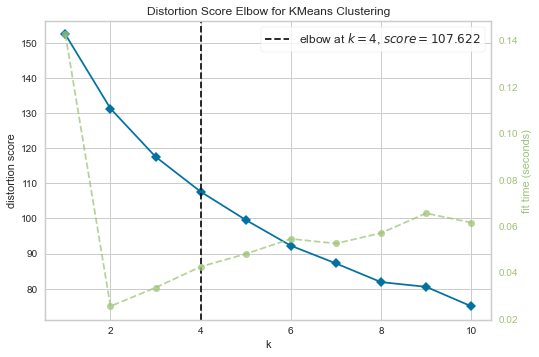

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [68]:
restaurants_clustering = restaurant_grouped.drop('Neighborhood', 1) 
model = KMeans()
visualizer = KElbowVisualizer(model, k=(1,11))

visualizer.fit(restaurants_clustering) # Fit the data to the visualizer
visualizer.show()

In [70]:
# set number of clusters
kclusters = 4

restaurant_grouped_clustering = restaurant_grouped.drop('Neighborhood', 1)

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(restaurant_grouped_clustering)

# check cluster labels generated for each row in the dataframe
kmeans.labels_[0:10] 

array([1, 0, 1, 3, 3, 0, 2, 3, 3, 2])

In [73]:
# add clustering labels
restaurant_grouped.insert(0, 'Cluster Labels', kmeans.labels_)



ValueError: cannot insert Cluster Labels, already exists

In [75]:
london_merged = df

# merge london_grouped with london_data to add latitude/longitude for each neighborhood
london_merged = london_merged.join(restaurant_grouped.set_index('Neighborhood'), on='Neighborhood')

london_merged.head() # check the last columns!

,Neighborhood,Borough,Latitude,Longitude,Average_Age,Employment_Rate,Population0-15,Population0-65,Population65+,Estimate_Household_Median,...,Taco Place,Taiwanese Restaurant,Tapas Restaurant,Thai Restaurant,Turkish Restaurant,Udon Restaurant,Vegetarian / Vegan Restaurant,Veneto Restaurant,Vietnamese Restaurant,Xinjiang Restaurant
0,Abbey Wood,Bexley,51.486484,0.109318,38.9,75.1,20.8,89.0,11.0,44430.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Acton,Ealing,51.510591,-0.264585,36.1,72.7,21.2,88.3,11.7,45690.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,Addington,Croydon,51.362934,-0.025780,36.9,75.4,22.3,87.0,13.0,45120.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Addiscombe,Croydon,51.381625,-0.068126,36.9,75.4,22.3,87.0,13.0,45120.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,Albany Park,Bexley,51.434929,0.125663,38.9,75.1,20.8,89.0,11.0,44430.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [93]:
# Drop neighbourhoods missing restaurant data 
london_merged = london_merged.dropna()
london_merged['Cluster Labels']=london_merged['Cluster Labels'].astype('int')

## Visualize Clusters

In [98]:
# create map
map_clusters = folium.Map(location=[51.5,0], zoom_start=11)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.jet(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(london_merged['Latitude'], london_merged['Longitude'], london_merged['Neighborhood'], london_merged['Cluster Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_clusters)
       
map_clusters

## Examine Clusters 
It would be interesting how these clusters came to be, aka further analysis in the k-means process. For me this is a little bit unclear.(As well in the example of New York)

Cluster 1

In [99]:
london_merged.loc[london_merged['Cluster Labels'] == 0, london_merged.columns[[1] + list(range(5, london_merged.shape[1]))]]

,Borough,Employment_Rate,Population0-15,Population0-65,Population65+,Estimate_Household_Median,Business_Suvrival_Rate_Two_Years,Number_Cars,Number_Cars_per_Houshold,LifeSatisfaction,...,Taco Place,Taiwanese Restaurant,Tapas Restaurant,Thai Restaurant,Turkish Restaurant,Udon Restaurant,Vegetarian / Vegan Restaurant,Veneto Restaurant,Vietnamese Restaurant,Xinjiang Restaurant
3,Croydon,75.4,22.3,87.0,13.0,45120.0,74.0,140049.0,1.0,7.10,...,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0
10,Islington,72.6,16.0,91.1,8.9,54950.0,69.0,38629.0,0.4,7.17,...,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0
19,Barking and Dagenham,65.8,21.0,86.1,13.9,34080.0,73.0,56966.0,0.8,7.14,...,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0
44,Bexley,75.1,20.8,89.0,11.0,44430.0,75.0,108507.0,1.2,7.38,...,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0
48,Bexley,75.1,20.8,89.0,11.0,44430.0,75.0,108507.0,1.2,7.38,...,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0
61,Enfield,73.0,22.7,87.2,12.8,41250.0,74.0,119653.0,1.0,7.26,...,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0
63,Lewisham,75.9,20.6,90.7,9.3,43360.0,75.0,76507.0,0.7,7.18,...,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0
87,Greenwich,72.1,21.8,89.4,10.6,44370.0,71.0,78185.0,0.8,7.20,...,0.0,0.0,0.0,0.333333,0.0,0.0,0.0,0.0,0.0,0.0
92,Kingston upon Thames,74.4,19.0,87.0,13.0,56920.0,79.0,70421.0,1.1,7.34,...,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0
104,Barnet,68.5,21.0,83.3,16.7,54530.0,70.0,144717.0,1.1,7.48,...,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0


cluster 2

In [100]:
london_merged.loc[london_merged['Cluster Labels'] == 1, london_merged.columns[[1] + list(range(5, london_merged.shape[1]))]]

,Borough,Employment_Rate,Population0-15,Population0-65,Population65+,Estimate_Household_Median,Business_Suvrival_Rate_Two_Years,Number_Cars,Number_Cars_per_Houshold,LifeSatisfaction,...,Taco Place,Taiwanese Restaurant,Tapas Restaurant,Thai Restaurant,Turkish Restaurant,Udon Restaurant,Vegetarian / Vegan Restaurant,Veneto Restaurant,Vietnamese Restaurant,Xinjiang Restaurant
1,Ealing,72.7,21.2,88.3,11.7,45690.0,74.0,112845.0,0.9,7.29,...,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.00,0.0
4,Bexley,75.1,20.8,89.0,11.0,44430.0,75.0,108507.0,1.2,7.38,...,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.00,0.0
40,Bexley,75.1,20.8,89.0,11.0,44430.0,75.0,108507.0,1.2,7.38,...,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.00,0.0
55,Haringey,71.3,19.5,90.7,9.3,45860.0,71.0,61515.0,0.6,7.24,...,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.00,0.0
71,Barnet,68.5,21.0,83.3,16.7,54530.0,70.0,144717.0,1.1,7.48,...,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.00,0.0
96,Waltham Forest,73.1,21.8,89.8,10.2,39460.0,71.0,76217.0,0.8,7.19,...,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.00,0.0
97,Bromley,75.3,15.8,88.4,11.6,55140.0,77.0,153908.0,1.2,7.54,...,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.00,0.0
106,Merton,78.8,20.5,87.9,12.1,57160.0,72.0,72777.0,0.9,7.28,...,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.00,0.0
116,Havering,76.5,19.5,81.5,18.5,44430.0,77.0,117634.0,1.2,7.39,...,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.00,0.0
122,Bexley,75.1,20.8,89.0,11.0,44430.0,75.0,108507.0,1.2,7.38,...,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.00,0.0


Cluster 3

In [101]:
london_merged.loc[london_merged['Cluster Labels'] == 2, london_merged.columns[[1] + list(range(5, london_merged.shape[1]))]]

,Borough,Employment_Rate,Population0-15,Population0-65,Population65+,Estimate_Household_Median,Business_Suvrival_Rate_Two_Years,Number_Cars,Number_Cars_per_Houshold,LifeSatisfaction,...,Taco Place,Taiwanese Restaurant,Tapas Restaurant,Thai Restaurant,Turkish Restaurant,Udon Restaurant,Vegetarian / Vegan Restaurant,Veneto Restaurant,Vietnamese Restaurant,Xinjiang Restaurant
11,Bromley,75.3,15.8,88.4,11.6,55140.0,77.0,153908.0,1.2,7.54,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
15,Enfield,73.0,22.7,87.2,12.8,41250.0,74.0,119653.0,1.0,7.26,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
42,Kingston upon Thames,74.4,19.0,87.0,13.0,56920.0,79.0,70421.0,1.1,7.34,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
95,Lewisham,75.9,20.6,90.7,9.3,43360.0,75.0,76507.0,0.7,7.18,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
133,Southwark,74.2,18.1,92.1,7.9,48000.0,71.0,60438.0,0.5,7.47,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.5,0.0
136,Brent,69.5,20.1,82.5,17.5,39630.0,70.0,87802.0,0.8,7.25,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
165,Bexley,75.1,20.8,89.0,11.0,44430.0,75.0,108507.0,1.2,7.38,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
233,Hounslow,74.2,21.0,88.7,11.3,44490.0,74.0,94042.0,1.0,7.31,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
322,Barnet,68.5,21.0,83.3,16.7,54530.0,70.0,144717.0,1.1,7.48,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
338,Bexley,75.1,20.8,89.0,11.0,44430.0,75.0,108507.0,1.2,7.38,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


Cluster 4

In [102]:
london_merged.loc[london_merged['Cluster Labels'] == 3, london_merged.columns[[1] + list(range(5, london_merged.shape[1]))]]

,Borough,Employment_Rate,Population0-15,Population0-65,Population65+,Estimate_Household_Median,Business_Suvrival_Rate_Two_Years,Number_Cars,Number_Cars_per_Houshold,LifeSatisfaction,...,Taco Place,Taiwanese Restaurant,Tapas Restaurant,Thai Restaurant,Turkish Restaurant,Udon Restaurant,Vegetarian / Vegan Restaurant,Veneto Restaurant,Vietnamese Restaurant,Xinjiang Restaurant
7,Westminster,65.6,15.3,87.9,12.1,80760.0,64.0,48810.0,0.5,7.25,...,0.0,0.0,0.043478,0.000000,0.0,0.0,0.0,0.0,0.0,0.0
12,Islington,72.6,16.0,91.1,8.9,54950.0,69.0,38629.0,0.4,7.17,...,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0
13,Havering,76.5,19.5,81.5,18.5,44430.0,77.0,117634.0,1.2,7.39,...,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0
16,Wandsworth,78.8,17.3,90.6,9.4,66220.0,75.0,89513.0,0.7,7.37,...,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0
17,Southwark,74.2,18.1,92.1,7.9,48000.0,71.0,60438.0,0.5,7.47,...,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
516,Merton,78.8,20.5,87.9,12.1,57160.0,72.0,72777.0,0.9,7.28,...,0.0,0.0,0.000000,0.153846,0.0,0.0,0.0,0.0,0.0,0.0
517,Enfield,73.0,22.7,87.2,12.8,41250.0,74.0,119653.0,1.0,7.26,...,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0
519,Redbridge,68.3,23.1,87.9,12.1,45380.0,71.0,106339.0,1.1,7.32,...,0.0,0.0,0.000000,0.000000,0.5,0.0,0.0,0.0,0.0,0.0
520,Redbridge,68.3,23.1,87.9,12.1,45380.0,71.0,106339.0,1.1,7.32,...,0.0,0.0,0.000000,0.000000,0.5,0.0,0.0,0.0,0.0,0.0
